<a href="https://colab.research.google.com/github/fortune-max/M4-python-refresher-ml/blob/main/Copy_of_exam_variant_0081.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
!mkdir exam_81_files
%cd exam_81_files
!pwd

mkdir: exam_81_files: File exists


/Users/fortune/code/personal/DS/M4/exam_81_files
/Users/fortune/code/personal/DS/M4/exam_81_files


/Users/fortune/code/personal/DS/M4/.venv/lib/python3.11/site-packages/IPython/core/magics/osm.py:417: UserWarning: using dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


#### Exam task 1:
- Download dataset Drug Review Dataset (Druglib.com) from https://archive.ics.uci.edu/ml/datasets/Drug+Review+Dataset+%28Druglib.com%29,
- load dataset to pandas, column names are present in the dataset
- Create target 0/1 variable from effectiveness == Highly Effective.
- For all textual features create feature with lenght of string and number of words in it.
- draw histograms and distributions for all numeric variables, and store them in .png file
- split the dataset to train and test
- store yaml file with data on dataset split origins and loading specific

In [4]:
!wget https://archive.ics.uci.edu/static/public/461/drug+review+dataset+druglib+com.zip
!unzip drug+review+dataset+druglib+com.zip
!ls

--2023-12-15 09:22:40--  https://archive.ics.uci.edu/static/public/461/drug+review+dataset+druglib+com.zip
Resolving archive.ics.uci.edu (archive.ics.uci.edu)... 128.195.10.252
Connecting to archive.ics.uci.edu (archive.ics.uci.edu)|128.195.10.252|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified
Saving to: ‘drug+review+dataset+druglib+com.zip’

drug+review+dataset     [     <=>            ]   1,08M  1,01MB/s    in 1,1s    

2023-12-15 09:22:42 (1,01 MB/s) - ‘drug+review+dataset+druglib+com.zip’ saved [1133354]

Archive:  drug+review+dataset+druglib+com.zip
  inflating: drugLibTest_raw.tsv     
  inflating: drugLibTrain_raw.tsv    
drug+review+dataset+druglib+com.zip drugLibTrain_raw.tsv
drugLibTest_raw.tsv


In [6]:
import pandas as pd
drug_lib = pd.read_csv("drugLibTrain_raw.tsv", sep='\t')
drug_lib.head()

,Unnamed: 0,urlDrugName,rating,effectiveness,sideEffects,condition,benefitsReview,sideEffectsReview,commentsReview
0,2202,enalapril,4,Highly Effective,Mild Side Effects,management of congestive heart failure,slowed the progression of left ventricular dys...,"cough, hypotension , proteinuria, impotence , ...","monitor blood pressure , weight and asses for ..."
1,3117,ortho-tri-cyclen,1,Highly Effective,Severe Side Effects,birth prevention,Although this type of birth control has more c...,"Heavy Cycle, Cramps, Hot Flashes, Fatigue, Lon...","I Hate This Birth Control, I Would Not Suggest..."
2,1146,ponstel,10,Highly Effective,No Side Effects,menstrual cramps,I was used to having cramps so badly that they...,Heavier bleeding and clotting than normal.,I took 2 pills at the onset of my menstrual cr...
3,3947,prilosec,3,Marginally Effective,Mild Side Effects,acid reflux,The acid reflux went away for a few months aft...,"Constipation, dry mouth and some mild dizzines...",I was given Prilosec prescription at a dose of...
4,1951,lyrica,2,Marginally Effective,Severe Side Effects,fibromyalgia,I think that the Lyrica was starting to help w...,I felt extremely drugged and dopey. Could not...,See above


In [10]:
print(drug_lib["effectiveness"].value_counts())
drug_lib["highly_effective"] = drug_lib["effectiveness"].apply(lambda x: 1 if x == "Highly Effective" else 0)
drug_lib.head()

Highly Effective          1330
Considerably Effective     928
Moderately Effective       415
Ineffective                247
Marginally Effective       187
Name: effectiveness, dtype: int64


,Unnamed: 0,urlDrugName,rating,effectiveness,sideEffects,condition,benefitsReview,sideEffectsReview,commentsReview,highly_effective
0,2202,enalapril,4,Highly Effective,Mild Side Effects,management of congestive heart failure,slowed the progression of left ventricular dys...,"cough, hypotension , proteinuria, impotence , ...","monitor blood pressure , weight and asses for ...",1
1,3117,ortho-tri-cyclen,1,Highly Effective,Severe Side Effects,birth prevention,Although this type of birth control has more c...,"Heavy Cycle, Cramps, Hot Flashes, Fatigue, Lon...","I Hate This Birth Control, I Would Not Suggest...",1
2,1146,ponstel,10,Highly Effective,No Side Effects,menstrual cramps,I was used to having cramps so badly that they...,Heavier bleeding and clotting than normal.,I took 2 pills at the onset of my menstrual cr...,1
3,3947,prilosec,3,Marginally Effective,Mild Side Effects,acid reflux,The acid reflux went away for a few months aft...,"Constipation, dry mouth and some mild dizzines...",I was given Prilosec prescription at a dose of...,0
4,1951,lyrica,2,Marginally Effective,Severe Side Effects,fibromyalgia,I think that the Lyrica was starting to help w...,I felt extremely drugged and dopey. Could not...,See above,0


In [19]:
text_cols = drug_lib.select_dtypes(include=['object']).columns
print(text_cols)

col_lengths = drug_lib[text_cols].applymap(lambda x: len(str(x).split()))
drug_lib["text_length"] = col_lengths.sum(axis=1)
drug_lib.head()

Index(['urlDrugName', 'effectiveness', 'sideEffects', 'condition',
       'benefitsReview', 'sideEffectsReview', 'commentsReview'],
      dtype='object')


,Unnamed: 0,urlDrugName,rating,effectiveness,sideEffects,condition,benefitsReview,sideEffectsReview,commentsReview,highly_effective,text_length
0,2202,enalapril,4,Highly Effective,Mild Side Effects,management of congestive heart failure,slowed the progression of left ventricular dys...,"cough, hypotension , proteinuria, impotence , ...","monitor blood pressure , weight and asses for ...",1,74
1,3117,ortho-tri-cyclen,1,Highly Effective,Severe Side Effects,birth prevention,Although this type of birth control has more c...,"Heavy Cycle, Cramps, Hot Flashes, Fatigue, Lon...","I Hate This Birth Control, I Would Not Suggest...",1,97
2,1146,ponstel,10,Highly Effective,No Side Effects,menstrual cramps,I was used to having cramps so badly that they...,Heavier bleeding and clotting than normal.,I took 2 pills at the onset of my menstrual cr...,1,136
3,3947,prilosec,3,Marginally Effective,Mild Side Effects,acid reflux,The acid reflux went away for a few months aft...,"Constipation, dry mouth and some mild dizzines...",I was given Prilosec prescription at a dose of...,0,171
4,1951,lyrica,2,Marginally Effective,Severe Side Effects,fibromyalgia,I think that the Lyrica was starting to help w...,I felt extremely drugged and dopey. Could not...,See above,0,57


In [31]:
drug_lib.drop("Unnamed: 0", axis=1, inplace=True)

Index(['rating', 'highly_effective', 'text_length'], dtype='object')


array([[<Axes: title={'center': 'rating'}>,
        <Axes: title={'center': 'highly_effective'}>,
        <Axes: title={'center': 'text_length'}>, <Axes: >],
       [<Axes: >, <Axes: >, <Axes: >, <Axes: >]], dtype=object)

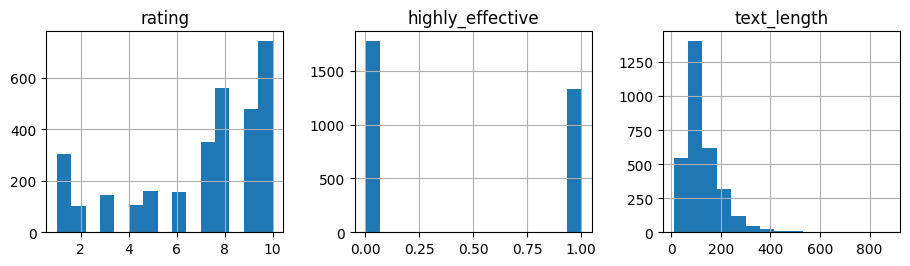

In [32]:
import matplotlib.pyplot as plt
num_cols = drug_lib.select_dtypes(include=['int64', 'float64']).columns
print(num_cols)

drug_lib[num_cols].hist(bins=15, figsize=(15, 6), layout=(2, 4))

In [71]:
from sklearn.model_selection import train_test_split

features = ["text_length", "rating"]
x_train, x_test, y_train, y_test = train_test_split(drug_lib[features], drug_lib["highly_effective"], test_size=0.2, random_state=42)
x_train.shape, x_test.shape, y_train.shape, y_test.shape, drug_lib.shape

((2485, 2), (622, 2), (2485,), (622,), (3107, 11))

In [35]:
import yaml

with open("random_state.yaml", "w") as f:
    yaml.dump({
        "description": "random state used for splitting the data",
        "random_state": 42,
        "test_size": 0.2
    }, f)

In [37]:
!cat random_state.yaml
    

description: random state used for splitting the data
random_state: 42
test_size: 0.2


#### Exam task 2:
- Create custom transformer consisting of standardScaler and polynomialTransformer with customizable parameters for all numerical features in the dataset
- Create a pipeline with this transformer and LogisticRegression classifier
- Create a .py module with custom transformer
- Measure quality results on test subsample with metric accuracy and store result in .yaml file


In [43]:
%%writefile task2.yaml

description: Parameters for trials on Task 2 (DrugLib dataset)
test1_random_state: 42
test1_degree: 2
test2_random_state: 93
test2_degree: 3

Overwriting task2.yaml


In [44]:
# open yaml file config
with open("task2.yaml", "r") as f:
    config = yaml.safe_load(f)

print(config)

{'description': 'Parameters for trials on Task 2 (DrugLib dataset)', 'test1_random_state': 42, 'test1_degree': 2, 'test2_random_state': 93, 'test2_degree': 3}


In [72]:
from experiments.classifiers.task_2_custom_classifier import CustomClassifierTask2
from sklearn.metrics import accuracy_score, precision_score, recall_score, adjusted_mutual_info_score

clf = CustomClassifierTask2(degree=config["test1_degree"], random_state=config["test1_random_state"])
clf.fit(x_train, y_train)
task_2_test_1_predictions = clf.predict(x_test)

acc_score = accuracy_score(y_test, task_2_test_1_predictions)
prec_score = precision_score(y_test, task_2_test_1_predictions)
rec_score = recall_score(y_test, task_2_test_1_predictions)
ami_score = adjusted_mutual_info_score(y_test, task_2_test_1_predictions)

print("Accuracy score: ", acc_score)
print("Precision score: ", prec_score)
print("Recall score: ", rec_score)
print("Adjusted Mutual Information score: ", ami_score)

# Store results in yaml file using writefile magic
!mkdir -p experiments/results/task2

yaml_content = f"""
name: Task 2 test 1
description: Custom classifier on DrugLib dataset
accuracyScore: {acc_score}
precisionScore: {prec_score}
recallScore: {rec_score}
amiScore: {ami_score}
"""

%store yaml_content >experiments/results/task2.yaml


Accuracy score:  0.7861736334405145
Precision score:  0.7624521072796935
Recall score:  0.737037037037037
Adjusted Mutual Information score:  0.24335689220174145


Writing 'yaml_content' (str) to file 'experiments/results/task2.yaml'.


<Axes: >

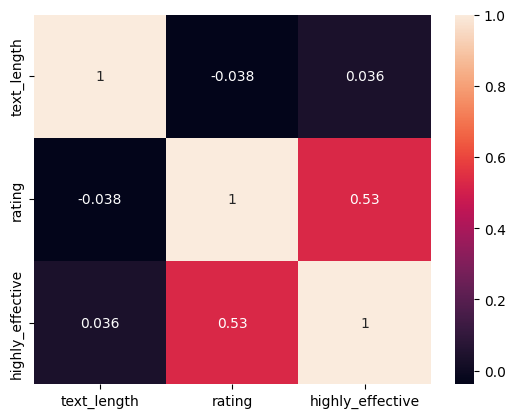

In [73]:
import seaborn as sns
drug_lib[['rating', 'effectiveness_score']].corr()
sns.heatmap(drug_lib[[*features, "highly_effective"]].corr(), annot=True)

In [74]:
clf_2 = CustomClassifierTask2(degree=config["test2_degree"], random_state=config["test2_random_state"])
clf_2.fit(x_train, y_train)
task_2_test_2_predictions = clf.predict(x_test)

acc_score = accuracy_score(y_test, task_2_test_2_predictions)
prec_score = precision_score(y_test, task_2_test_2_predictions)
rec_score = recall_score(y_test, task_2_test_2_predictions)
ami_score = adjusted_mutual_info_score(y_test, task_2_test_2_predictions)

print("Accuracy score: ", acc_score)
print("Precision score: ", prec_score)
print("Recall score: ", rec_score)
print("Adjusted Mutual Information score: ", ami_score)

# Store results in yaml file using writefile magic
!mkdir -p experiments/results/task2

yaml_content = f"""
name: Task 2 test 1
description: Custom classifier on DrugLib dataset
accuracyScore: {acc_score}
precisionScore: {prec_score}
recallScore: {rec_score}
amiScore: {ami_score}
"""

%store yaml_content >experiments/results/task2_2.yaml

Accuracy score:  0.7861736334405145
Precision score:  0.7624521072796935
Recall score:  0.737037037037037
Adjusted Mutual Information score:  0.24335689220174145
Writing 'yaml_content' (str) to file 'experiments/results/task2_2.yaml'.


#### Exam task 3:
- Create a custom classifier that uses bag of characters 2-grams with PCA to extract data from a textual feature and 'XGBoost's a main classifier
- Implement is as a .py module, also implement using .yaml file for setting up bagging parameters min_df, max_df etc. Create a .yaml file for initialization of classifier
- Measure quality results on test subsample with metric recall and store result in .yaml file


In [112]:
features = ["commentsReview", "sideEffectsReview", "benefitsReview"]

x_train, x_test, y_train, y_test = train_test_split(drug_lib[features], drug_lib["highly_effective"], test_size=0.2, random_state=42)

In [114]:
from experiments.classifiers.task_3_classifier import CustomClassifierTask3

CustomClassifierTask3(min_df=1, max_df=1).fit(x_train, y_train)

XGBoostError: [11:07:29] /Users/runner/work/xgboost/xgboost/src/data/data.cc:501: Check failed: this->labels.Size() % this->num_row_ == 0 (1 vs. 0) : Incorrect size for labels.
Stack trace:
  [bt] (0) 1   libxgboost.dylib                    0x000000013cbb7355 dmlc::LogMessageFatal::~LogMessageFatal() + 117
  [bt] (1) 2   libxgboost.dylib                    0x000000013cc8dc83 xgboost::MetaInfo::SetInfoFromHost(xgboost::Context const&, xgboost::StringView, xgboost::Json) + 3491
  [bt] (2) 3   libxgboost.dylib                    0x000000013cc8cdf2 xgboost::MetaInfo::SetInfo(xgboost::Context const&, xgboost::StringView, xgboost::StringView) + 146
  [bt] (3) 4   libxgboost.dylib                    0x000000013cbcf729 XGDMatrixSetInfoFromInterface + 233
  [bt] (4) 5   libffi.dylib                        0x00007ff8146be8c2 ffi_call_unix64 + 82
  [bt] (5) 6   ???                                 0x00007ff7b231e210 0x0 + 140701823263248



#### Exam task 4:
- Create a custom classifier with pipeline of polynomial feature generation for numeric features, PCA dimensionality reduction and linear regression with parameters of regularization l1
- Perform gridSearch for optimal classifier parameters:

-- polynomial degree from 5 to 10

-- PCA degreee from 15 to 25

-- l1 regularization 0.081 to 0.162

- Measure quality results on test subsample with metric accuracy and store result in .yaml file


In [135]:
from experiments.classifiers.task_4_custom_classifier import CustomClassifierTask4

grid_param = {
    'degree': list(range(15, 26)),
    'n_components': list(range(15, 25)),
    'random_state': [42, 948, 554],
    'alpha': [0.081, 0.09, 0.10, 0.11, 0.12, 0.13, 0.14, 0.15, 0.162]
}

from sklearn import model_selection
classifier = CustomClassifierTask4()
grid_search_classifier = model_selection.GridSearchCV(classifier,
                     param_grid=grid_param,
                     scoring='accuracy',
                     cv=5)
grid_search_classifier

GridSearchCV(cv=5, estimator=CustomClassifierTask4(),
             param_grid={'alpha': [0.081, 0.09, 0.1, 0.11, 0.12, 0.13, 0.14,
                                   0.15, 0.162],
                         'degree': [15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25],
                         'n_components': [15, 16, 17, 18, 19, 20, 21, 22, 23,
                                          24],
                         'random_state': [42, 948, 554]},
             scoring='accuracy')

In [138]:
features = ["text_length", "rating"]
x_train, x_test, y_train, y_test = train_test_split(drug_lib[features], drug_lib["highly_effective"], test_size=0.2, random_state=42)
x_train.shape, x_test.shape, y_train.shape, y_test.shape, drug_lib.shape

((2485, 2), (622, 2), (2485,), (622,), (3107, 11))

In [139]:
%%time
grid_search_classifier.fit(x_train, y_train)

/Users/fortune/code/personal/DS/M4/.venv/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:821: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/fortune/code/personal/DS/M4/.venv/lib/python3.11/site-packages/sklearn/model_selection/_validation.py", line 810, in _score
    scores = scorer(estimator, X_test, y_test)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/fortune/code/personal/DS/M4/.venv/lib/python3.11/site-packages/sklearn/metrics/_scorer.py", line 266, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/fortune/code/personal/DS/M4/.venv/lib/python3.11/site-packages/sklearn/metrics/_scorer.py", line 355, in _score
    return self._sign * self._score_func(y_true, y_pred, **scoring_kwargs

KeyboardInterrupt: 

GridSearch runs for too long, had to terminate X_X

#### Exam task 5*:
Perform a free search of best classifier in accuracy metric, save the resulting quality in .yaml, classifier code in .py file and trained classifier in .pkl file. Make sure the result is reproducible, so your classifier can be used and quality results can be confirmed via set of files and descritions you gave


In [134]:
# ignore this cell, it is just for reloading the modules
import importlib

importlib.reload(task_2_custom_classifier)
importlib.reload(experiments.classifiers.task_3_classifier)
importlib.reload(experiments.transformers.bigram)
importlib.reload(experiments.transformers.polynomial)
importlib.reload(experiments.classifiers.task_4_custom_classifier)

from experiments.transformers.bigram import BigramTransformer
from experiments.transformers.polynomial import PolynomialTransformer
from experiments.classifiers.task_2_custom_classifier import CustomClassifierTask2
from experiments.classifiers.task_3_classifier import CustomClassifierTask3
from experiments.classifiers.task_4_custom_classifier import CustomClassifierTask4